## Advanced Lane Finding ##
The goal of this project is to write a software pipeline to identify the lane boundaries in a video from a front-facing camera in a car.

The steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


## Define Global Variables/Utilities functions ##

In [2]:
# import required libs
import numpy as np
import cv2
import os
import glob
import pickle
import math
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from moviepy.editor import VideoFileClip
from collections import deque
%matplotlib inline

In [3]:
chessboard_shape=(9, 6)
ratio = (10, 12)
scale = 10
offset = (600, 300)
ksize=7
gradient_x_threshold=(0, 30)
gradient_y_threshold=(20, 90)
gradient_magnitude_threshold=(0, 10)
gradient_direction_threshold=(0, np.pi / 4)
# Define source points and destination 

src_points = np.float32([[540, 488],[750, 488],[777, 508], [507, 508]])
dst_points = np.float32([[offset[0], offset[1]],[offset[0] + ratio[0] * scale, offset[1]],[offset[0] + ratio[0] * scale, offset[1] + ratio[1] * scale],[offset[0], offset[1] + ratio[1] * scale]])
    

output_images_dir = './output_images'

def save_image(fname, sub_dir, image):
    """
    Saves image to the disc
    
    :param sub_dir : the folder where to save the image 
    :Param fname : The image filename
    :param image : The image to be saved
    :return: none
    """
    output_dir = output_images_dir + '/' + sub_dir + '/'
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    cv2.imwrite(filename=output_dir + '/' + fname, img=image)  



## Camera Calibration ##

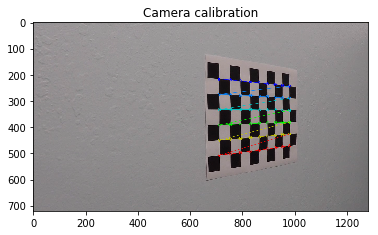

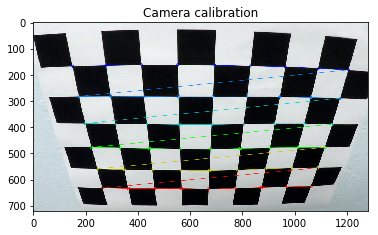

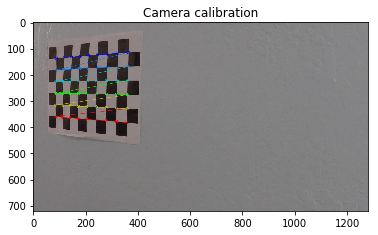

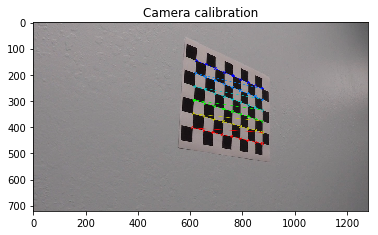

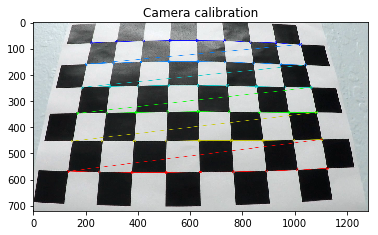

...

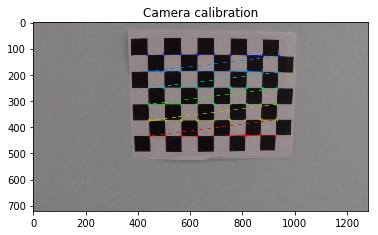

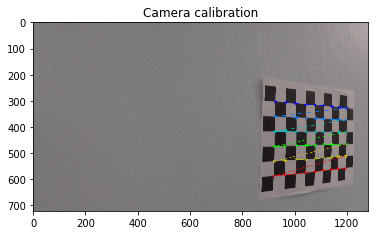

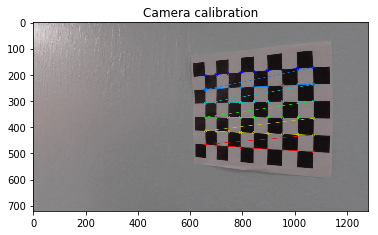

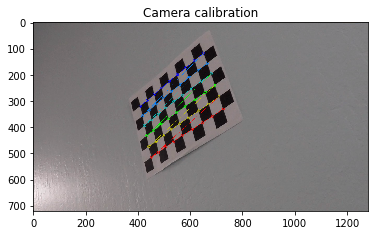

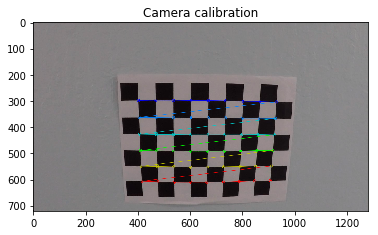

In [4]:
# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

#Number of corners
nx = 9
ny = 6

# Generate coordinates for object points
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

images_calib = glob.glob('./camera_cal/*.jpg')

for fname in images_calib:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners2,ret)
        fig = plt.figure()
        plt.imshow(img)
        plt.title('Camera calibration')
        
# Perform the camera calibration
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
        
# Create a dictionary with camera info        
calibration_info = { "ret": ret, "mtx": mtx, "dist": dist, "rvecs": rvecs,
"tvecs": tvecs }

# Save camera calibration info in a file
pickle.dump( calibration_info, open( "calibration.p", "wb" ) )

## Apply Distortion Correction to images ##

In [5]:

# Apply a distortion correction to raw images
def undistort(img, mtx, dist, show=False):

    undist = cv2.undistort(img, mtx, dist)
    
    if show:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15,15))
        ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB) )
        ax1.set_title('Original Image')
        ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
        ax2.set_title('Undistorted Image')
    
    return undist

## Threshold Image ##
* Define Mask to detect lines : Region Of Interest (ROI)
* Use color transforms, gradients, etc., to create a thresholded binary image.


In [6]:
def region_of_interest(img, source_image,fname, save=False):
    """
    Applies an image mask.
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """

    points = np.array([[190, 660],[580, 435],[700, 435],[1100, 660]]) 
    vertices = np.int32([points])

    # defining a blank mask to start with
    mask = np.zeros_like(img)

    # defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255

    # filling pixels inside the polygon defined by "vertices" with the fill color
    cv2.fillPoly(mask, vertices, ignore_mask_color)

    # returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)

    annotated_image = source_image.copy()
    cv2.fillPoly(annotated_image, vertices, (255, 255, 255))
    # annotated_image= cv2.addWeighted(annotated_image, 1, mask, 0.3, 0)
    if save:
        save_image(fname, sub_dir='region', image=annotated_image)

    return masked_image
    
def color_threshold(image, fname, save=False):
    """
    Removes pixels that are not within the color ranges
    :param image: 
    :param save: flag to save the image
    :param fname: image filename
    :return: image
    """
    yellow_lower_bound = np.array([
        int(0.2 * 255), 
        int(0.3 * 255), 
        int(0.10 * 255)
    ], dtype="uint8")
    
    yellow_upper_bound = np.array([
        int(0.6 * 255), 
        int(0.8 * 255), 
        int(0.90 * 255)
    ], dtype="uint8")

    white_lower_bound = np.array([
        int(0.0 * 255), 
        int(0.0 * 255), 
        int(0.80 * 255)
    ], dtype="uint8")
    
    white_upper_bound = np.array([
        int(1.0 * 255), 
        int(0.10 * 255), 
        int(1.0 * 255)
    ], dtype="uint8")
    
    yellow_lane_hsv_range = (yellow_lower_bound, yellow_upper_bound)
    
    white_lane_hsv_range = (white_lower_bound,white_upper_bound)
    
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    
    white_mask = cv2.inRange(image,lowerb=white_lane_hsv_range[0],upperb=white_lane_hsv_range[1])
    
    yellow_mask = cv2.inRange(image,lowerb=yellow_lane_hsv_range[0],upperb=yellow_lane_hsv_range[1])
        
    image = cv2.bitwise_or(white_mask, yellow_mask)
    
    if save:
        save_image(fname, sub_dir='color', image=image)
        
    return image

def edge_detection(image,fname, save=False):
    """
    Using the Sobel filter, find the edge pixels for the lane lines
    :param image: 
    :param save: save image to the disk
    :param fname: image filename 
    :return: 
    """
    # Define a function that takes an image, gradient orientation,
    # and threshold min / max values.
    def abs_sobel_thresh(img, orient='x', thresh=None, sobel_kernel=None):
        thresh_min = thresh[0]
        thresh_max = thresh[1]
        # Convert to grayscale
        gray = img
        # Apply x or y gradient with the OpenCV Sobel() function
        # and take the absolute value
        if orient == 'x':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
        elif orient == 'y':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
        else:
            raise Exception('Invalid `orient`')
        # Rescale back to 8 bit integer
        scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
        # Create a copy and apply the threshold
        binary_output = np.zeros_like(scaled_sobel)
        # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
        binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
        # Return the result
        return binary_output
    
    # Masks the image based on gradient magnitude.
    # Define a function to return the magnitude of the gradient
    # for a given sobel kernel size and threshold values
    def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
        # Convert to grayscale
        gray = img
        # Take both Sobel x and y gradients
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        # Calculate the gradient magnitude
        gradmag = np.sqrt(sobelx ** 2 + sobely ** 2)
        # Rescale to 8 bit
        scale_factor = np.max(gradmag) / 255
        gradmag = (gradmag / scale_factor).astype(np.uint8)
        # Create a binary image of ones where threshold is met, zeros otherwise
        binary_output = np.zeros_like(gradmag)
        binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
            
        # Return the binary image
        return binary_output
    
    # Masks the image based on gradient direction.
    def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi / 2)):
        # Grayscale
        # Calculate the x and y gradients
        gray = image
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        # Take the absolute value of the gradient direction,
        # apply a threshold, and create a binary image result
        absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
        binary_output = np.zeros_like(absgraddir)
        binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

        # Return the binary image
        return binary_output

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=gradient_x_threshold)
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=gradient_y_threshold)
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=gradient_magnitude_threshold)
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=gradient_direction_threshold)

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 0) & (grady == 0)) | ((mag_binary == 0) & (dir_binary == 0))] = 255

    if save:
        save_image(fname, sub_dir='binary', image=combined)

    return combined

## Test the masks

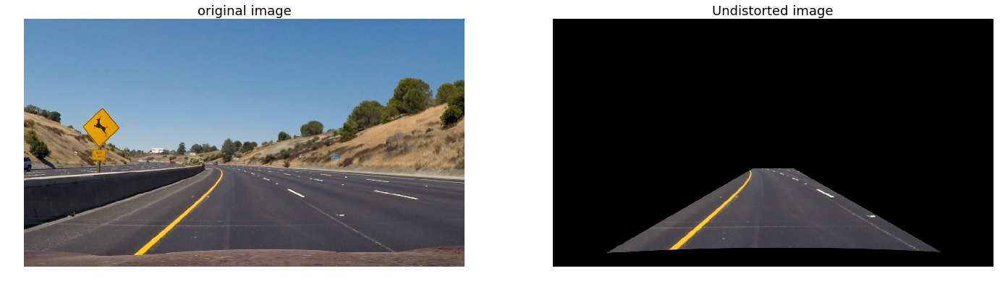

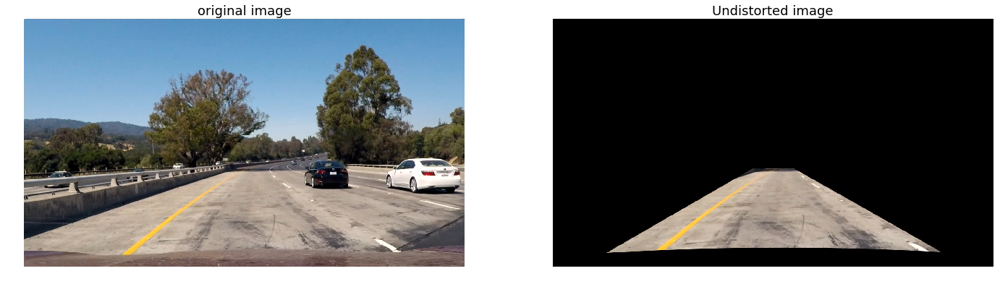

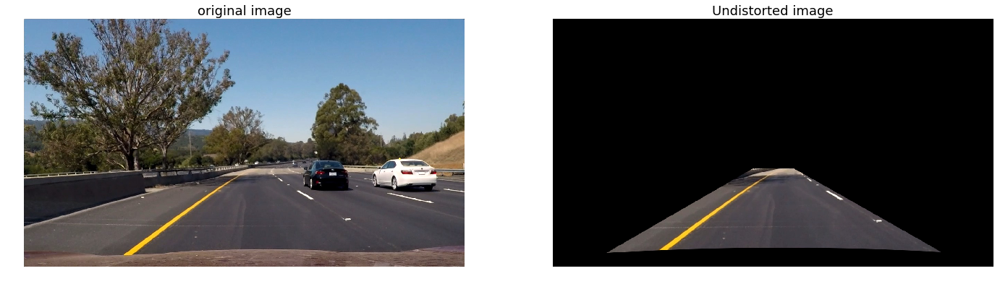

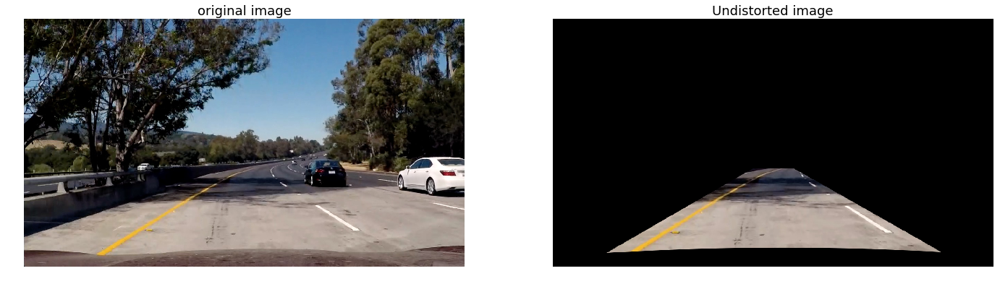

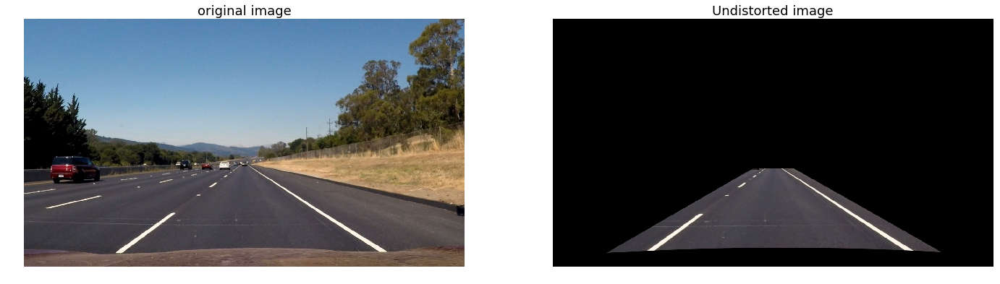

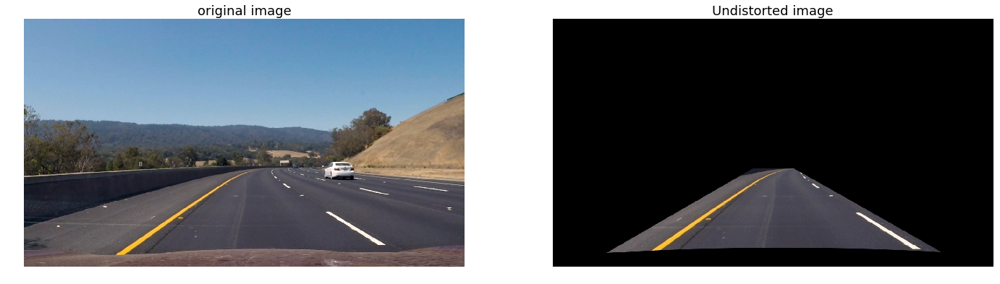

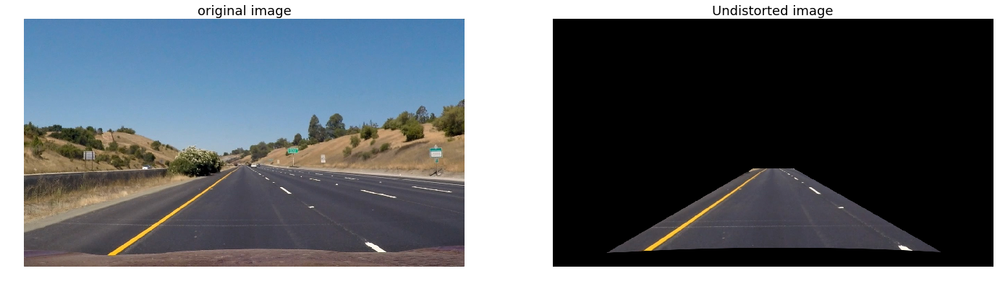

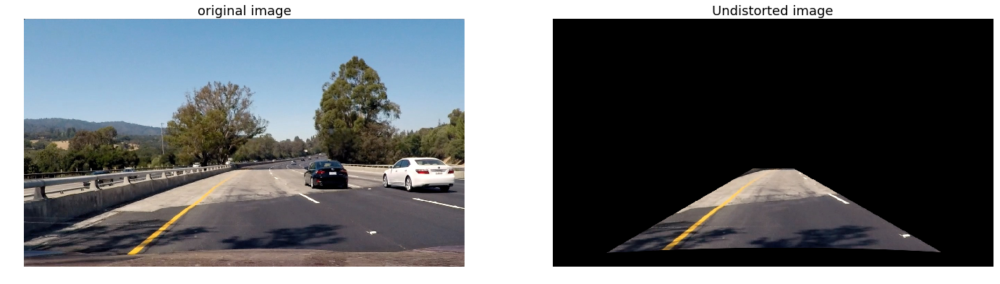

In [7]:
images_list = glob.glob('./test_images/*.jpg')
#Load calibration information
cal_info = pickle.load(open("calibration.p", "rb"))
mxt = cal_info["mtx"]
dist = cal_info["dist"]


for image in images_list:
    img = mpimg.imread(image)
    src_img = img.copy()
    fname   = image.split('/')[-1]
    roi_img = region_of_interest(img, src_img,fname, save=False)
    undistort_img = undistort(roi_img, mtx, dist, show=False)
    

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    #f.tight_layout()
    ax1.axis('off')
    ax1.imshow(src_img)
    ax1.set_title('original image', fontsize=18)
    ax2.axis('off')
    ax2.imshow(undistort_img)
    ax2.set_title('Undistorted image', fontsize=18)

## Perspective Transform
* Apply a perspective transform to rectify binary image ("birds-eye view") 

In [8]:
def perspective_transform(image, source_image, fname, save=False):

    # Grab the image shape
    img_shape = (image.shape[1], image.shape[0])
    
    # Given src_points and dst_points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    Minv = cv2.getPerspectiveTransform(dst_points, src_points)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(src=image, M=M, dsize=img_shape, flags=cv2.INTER_LINEAR)
    if save:
        #Saved perspective warped image
        psp_warped_img = cv2.warpPerspective(src=source_image, M=M, dsize=img_shape, flags=cv2.INTER_LINEAR)
        save_image(fname, sub_dir='perspective', image=psp_warped_img)
    # Return the resulting image and reverse transformation matrix
    return warped, Minv

## Test perspective transform
* Verify transformation by projecting points on image and warping to see if they are parallel

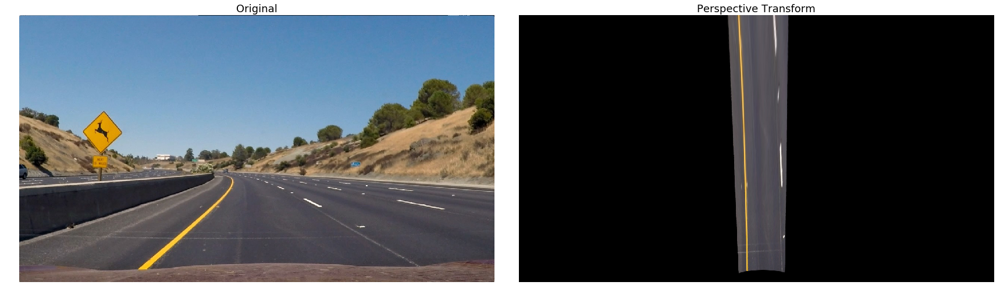

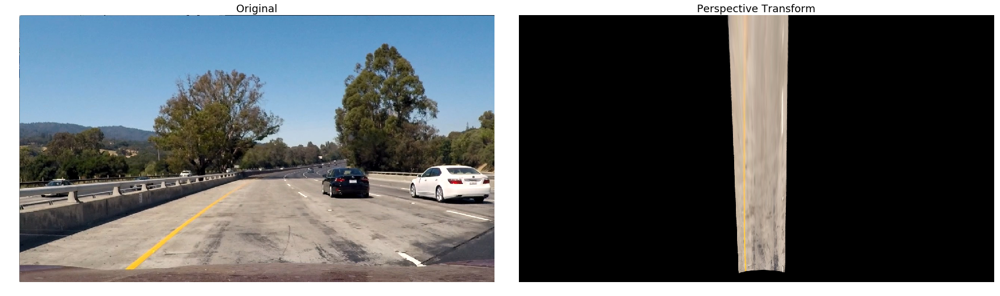

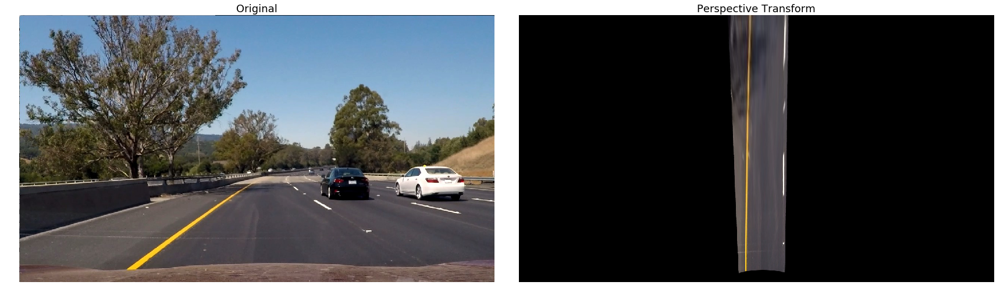

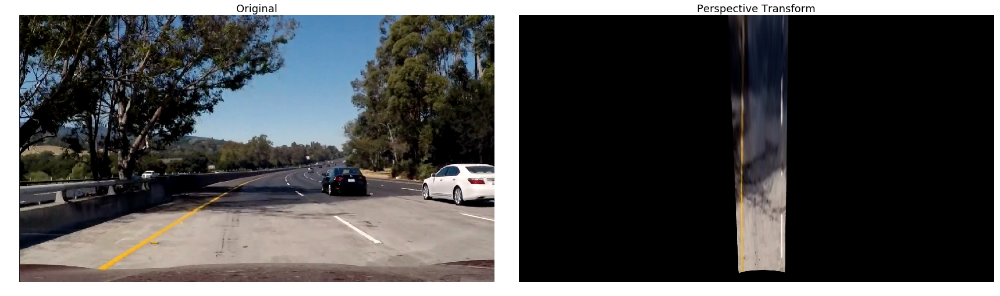

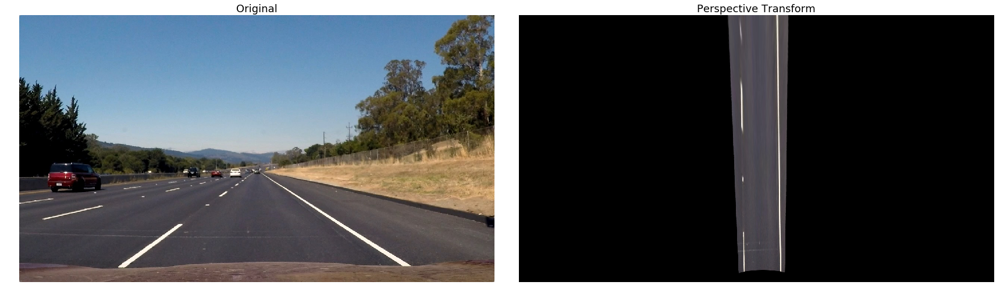

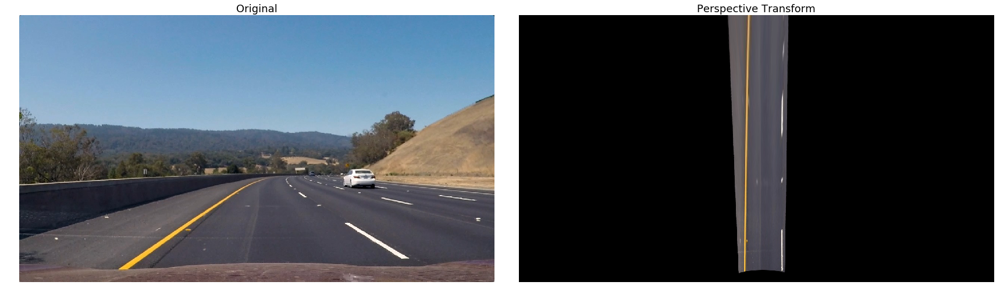

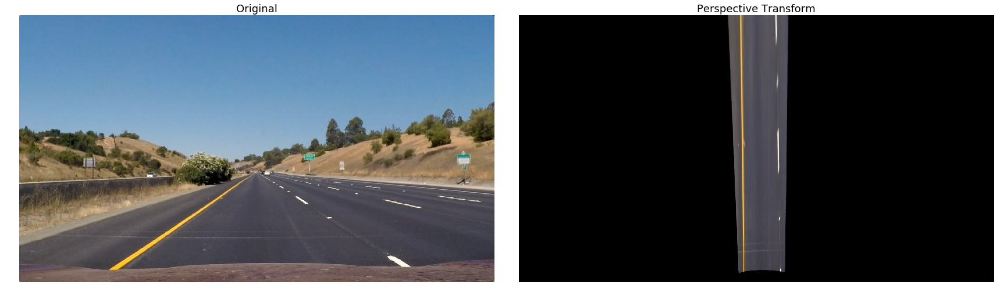

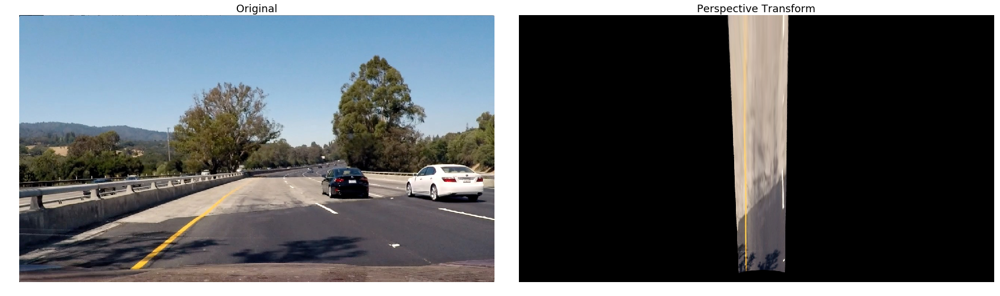

In [9]:
images_list = glob.glob('./test_images/*.jpg')

#Load calibration information
cal_info = pickle.load(open("calibration.p", "rb"))
mxt = cal_info["mtx"]
dist = cal_info["dist"]

for image in images_list:
    img = mpimg.imread(image)
    src_img = img.copy()
    fname   = image.split('/')[-1]
    roi_img = region_of_interest(img, src_img,fname, save=False)
    undistort_img = undistort(roi_img, mtx, dist, show=False)
    #Perspective transform
    warped, reverse = perspective_transform(undistort_img, src_img, fname, save=False)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.axis('off')
    ax1.imshow(src_img)
    ax1.set_title('Original', fontsize=18)
    ax2.axis('off')
    ax2.imshow(warped, cmap='gray')
    ax2.set_title('Perspective Transform', fontsize=18)

## Line Finding Method: Sliding Windows / Peaks in a Histogram

* Find Lane Pixels : Search for pixels belonging to the lane based on previously detected pixels.

In [10]:
def find_lane_pixels(image, fname,save=False):
    """
    Finds the pixels associated to the lane using a sliding window
    :param image: 
    :return: 
    """

    binary_warped = image
    window_margin=20
    window_min=5
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    half = int(binary_warped.shape[0] / 2)
    histogram = np.sum(binary_warped[half:, :], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped)) * 255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0] / 2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0] / nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = window_margin
    # Set minimum number of pixels found to recenter window
    minpix = window_min
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0, 255, 0), 2)
        cv2.rectangle(out_img, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0, 255, 0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (
            nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (
            nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        
    if save:
        save_image(fname, sub_dir='lane_pixels', image=out_img)
       
    return out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty

def annotate_lane(source_image, warped_image, reverse_matrix, left_fitx, right_fitx, ploty):
    """
    Draws the detected region of the lane lines
    :param source_image: 
    :param warped_image: 
    :param reverse_matrix: Used for undistorting the image
    :param left_fitx: 
    :param right_fitx: 
    :param ploty: 
    :return: 
    """
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped_image).astype(np.uint8)
    color_warp = warp_zero

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, reverse_matrix, (source_image.shape[1], source_image.shape[0]))
    # Combine the result with the original image
    return cv2.addWeighted(source_image, 1, newwarp, 0.3, 0)

def lane_stats(image_shape, left_fit, right_fit, ploty, leftx, rightx, lefty, righty):
    """
    Generates stats about the position and curvature of the lane
    :param image_shape: 
    :param left_fit: 
    :param right_fit: 
    :param ploty: 
    :param leftx: 
    :param rightx: 
    :param lefty: 
    :param righty: 
    :return: 
    """
    y_eval = image_shape[1]
    #  the lane is about 30 meters long and 3.7 meters wide
    #ym_per_pix = 30.0/720.0  # 30 meter is around 720 pixels
    #xm_per_pix = 3.7/700.0  # 3.7 meters is around 700pixels
    ym_per_pix = 12.0 / (dst_points[3][1] - dst_points[0][1])
    xm_per_pix = 10.0 / (dst_points[1][0] - dst_points[0][0])

    left = left_fit[0] * y_eval ** 2 + left_fit[1] * y_eval + left_fit[2]
    right = right_fit[0] * y_eval ** 2 + right_fit[1] * y_eval + right_fit[2]

    # feetPerPixel = 12 / (rightx - leftx)

    lane_midpoint_px = (right + left) / 2
    camera_midpoint_px = image_shape[0] / 2

    offset_from_center = np.abs(lane_midpoint_px - camera_midpoint_px) * xm_per_pix

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2 * left_fit_cr[0] * y_eval * ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * left_fit_cr[0])
    right_curverad = ((1 + (2 * right_fit_cr[0] * y_eval * ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * right_fit_cr[0])
    # Now our radius of curvature is in meters
    # print(left_curverad, 'm', right_curverad, 'm')

    return offset_from_center, np.min([left_curverad, right_curverad])

def display_numbers(image, offset_from_center, curverad):
    cv2.putText(image, 'Offset: {:.1f} Curve radius: {:.1f}'.format(offset_from_center, curverad), (30, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 2)

## Define Pipeline

In [11]:
def pipeline_process(img, filename):
    """
    Find the lane lines in the provided image
    :param image: 
    :return: 
    """
    src_img = img.copy()
    fname   = filename
    image = region_of_interest(img, src_img,fname, save=True)
    

    #Load calibration information
    cal_info = pickle.load(open("calibration.p", "rb"))
    mxt = cal_info["mtx"]
    dist = cal_info["dist"]
    #undistort image
    image = undistort(image, mtx, dist, show=True)
    
    image, reverse = perspective_transform(image, src_img, fname, save=True)
    #perspective_transform(image, src_img)

    image = color_threshold(image, fname, save=True)
    #color_threshold(image, fname, save=False)
    image = edge_detection(image,fname, save=True)
    #edge_detection(image,fname, save=False)

    image, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx,lefty, righty = find_lane_pixels(image, fname, save=True)
    image = annotate_lane(source_image=src_img, warped_image=image, reverse_matrix=reverse,
                                     left_fitx=left_fitx, right_fitx=right_fitx, ploty=ploty)
    offset_from_center, curverad = lane_stats(image_shape=(src_img.shape[1], src_img.shape[0]),
                          left_fit=left_fit, right_fit=right_fit, ploty=ploty, leftx=leftx, rightx=rightx, lefty=lefty, righty=righty)
    display_numbers(image, offset_from_center=offset_from_center, curverad=curverad)

    return image


## Test Pipeline on Images

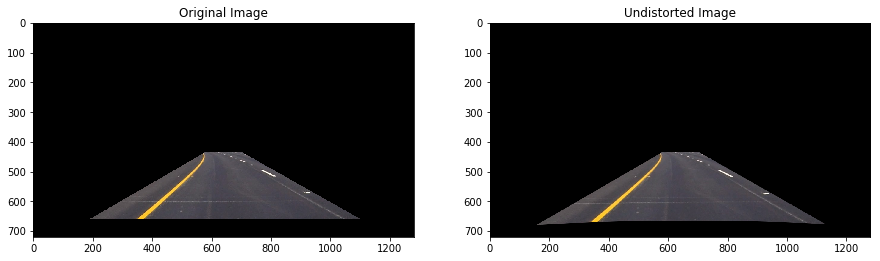

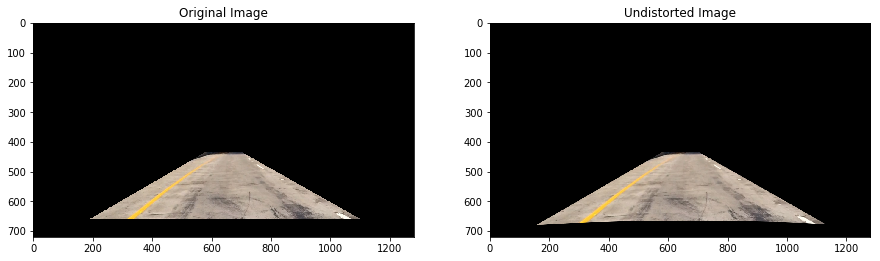

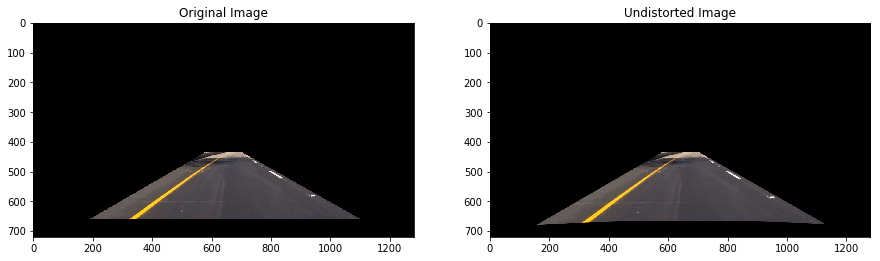

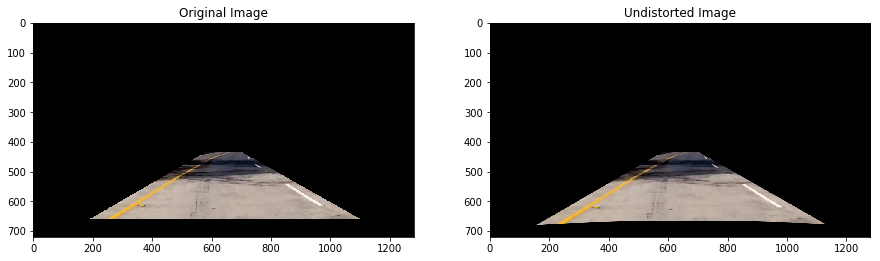

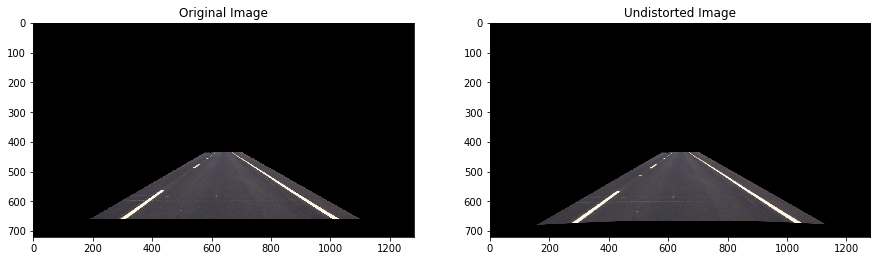

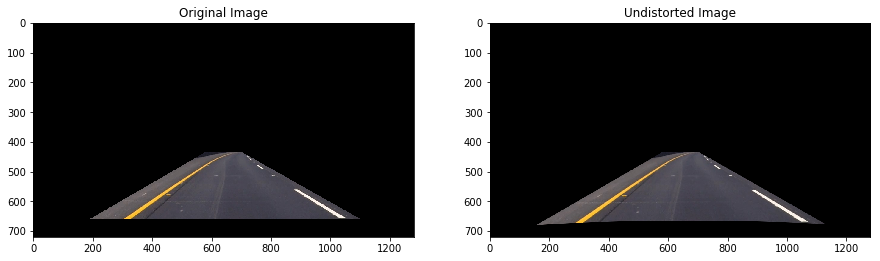

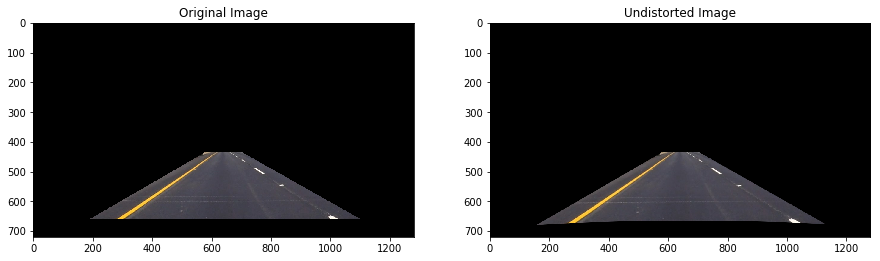

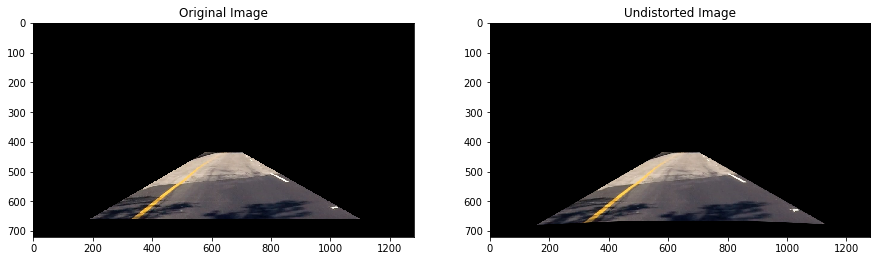

In [12]:
"""
img = mpimg.imread(image)
    src_img = img.copy()
    fname   = image.split('/')[-1]

"""
# Test Pipeline on images
test_images = glob.glob('./test_images/*.jpg')

for test_img in test_images:
    fname = test_img.split('/')[-1]
    image = cv2.imread(test_img)
    img = pipeline_process(image, fname)
    cv2.imwrite('./output_images/' + fname, img)

## Test Pipeline on Video

In [ ]:

from moviepy.editor import VideoFileClip



clip = VideoFileClip(filename="./project_video.mp4")

fname = "0_frame.png"
    
def process(image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = pipeline_process(image, fname)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    return image

clip = clip.fl_image(process)
clip.write_videofile(filename="./project_video_output.mp4", audio=False)

[MoviePy] >>>> Building video ./project_video_output.mp4
[MoviePy] Writing video ./project_video_output.mp4


 86%|████████▌ | 1083/1261 [15:26<02:34,  1.15it/s]

## Test Pipeline on Video Challenge

In [ ]:
#Process video challenge
from moviepy.editor import VideoFileClip

clip = VideoFileClip(filename="./challenge_video.mp4")
fname = "0_frame.png"

def process(image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = pipeline_process(image, fname)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    return image

clip = clip.fl_image(process)
clip.write_videofile(filename="./challenge_video_output.mp4", audio=False)

## Test Pipeline on Harder Video Challenge

[MoviePy] >>>> Building video ./harder_challenge_video_output.mp4
[MoviePy] Writing video ./harder_challenge_video_output.mp4


 50%|████▉     | 597/1200 [09:41<08:43,  1.15it/s]

TypeError: expected non-empty vector for x

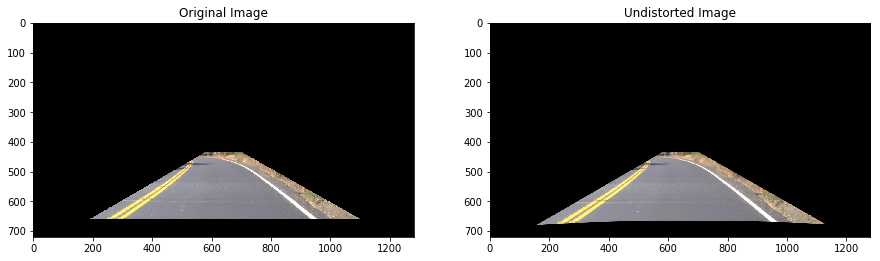

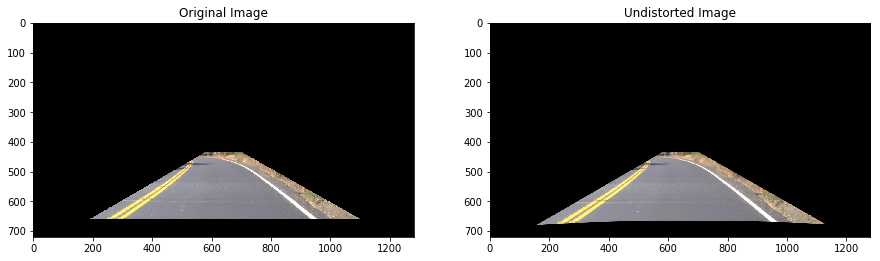

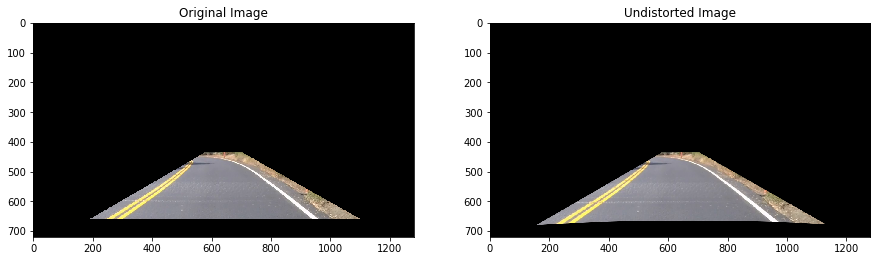

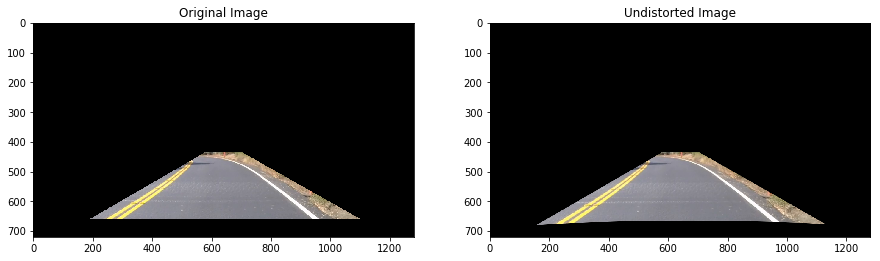

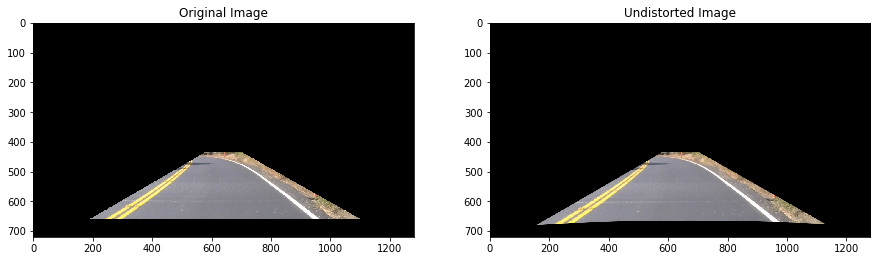

...

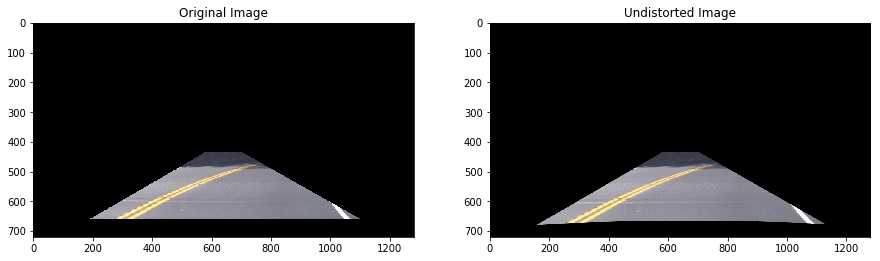

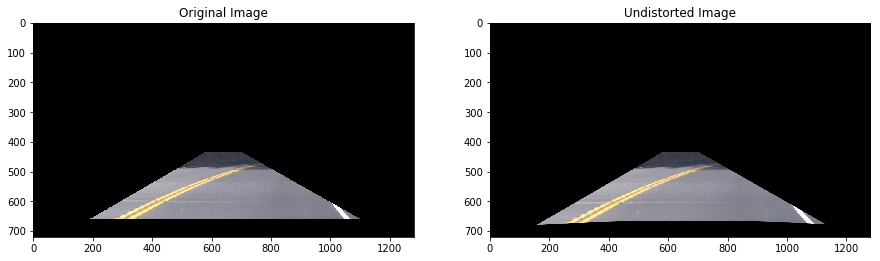

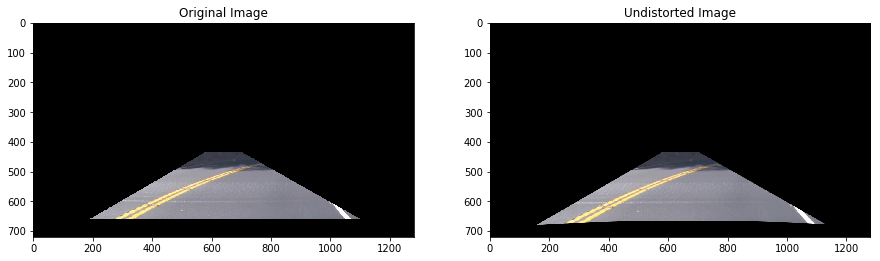

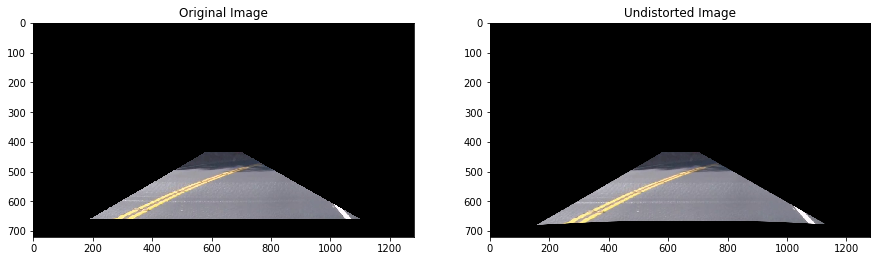

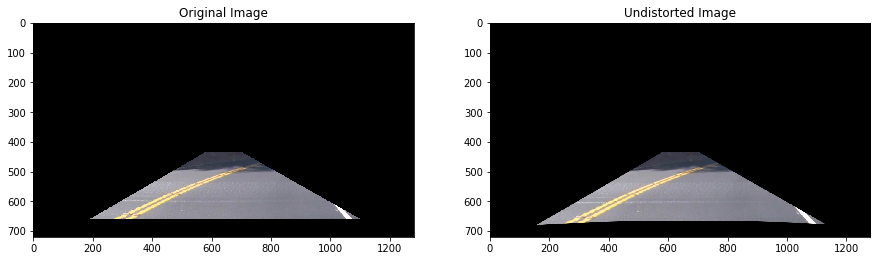

In [ ]:
#Process video challenge
from moviepy.editor import VideoFileClip

clip = VideoFileClip(filename="./harder_challenge_video.mp4")
fname = "0_frame.png"

def process(image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = pipeline_process(image, fname)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    return image

clip = clip.fl_image(process)
clip.write_videofile(filename="./harder_challenge_video_output.mp4", audio=False)